<a href="https://colab.research.google.com/github/Thorkee/BIM/blob/main/BIM_feature_matching_resized.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!git clone --quiet --recursive https://github.com/cvg/Hierarchical-Localization/
%cd Hierarchical-Localization
!pip install --progress-bar off --quiet -e .
!pip install --progress-bar off --quiet --upgrade plotly

import tqdm, tqdm.notebook
tqdm.tqdm = tqdm.notebook.tqdm  # notebook-friendly progress bars
from pathlib import Path

from hloc import extract_features, match_features, reconstruction, visualization, pairs_from_exhaustive
from hloc.visualization import plot_images, read_image
from hloc.utils import viz_3d

/content/Hierarchical-Localization
  Preparing metadata (setup.py) ... done
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [9]:
images = Path('/content/drive/MyDrive/PolyU/BIM Paper')
outputs = Path('/content/drive/MyDrive/PolyU/BIM Paper/outputs_resized')
!rm -rf $outputs
sfm_pairs = outputs / 'pairs-sfm.txt'
loc_pairs = outputs / 'pairs-loc.txt'
sfm_dir = outputs / 'sfm'
features = outputs / 'features.h5'
matches = outputs / 'matches.h5'

feature_conf = extract_features.confs['disk']
matcher_conf = match_features.confs['disk+lightglue']

# 3D mapping

307 mapping images


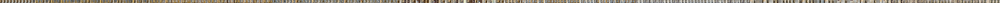

In [10]:
references = [str(p.relative_to(images)) for p in (images / 'Cameraresized/').iterdir()]
print(len(references), "mapping images")
plot_images([read_image(images / r) for r in references], dpi=25)

In [11]:
extract_features.main(feature_conf, images, image_list=references, feature_path=features)
pairs_from_exhaustive.main(sfm_pairs, image_list=references)
match_features.main(matcher_conf, sfm_pairs, features=features, matches=matches);

[2024/11/27 13:29:32 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


  0%|          | 0/307 [00:00<?, ?it/s]

[2024/11/27 13:30:04 hloc INFO] Finished exporting features.
[2024/11/27 13:30:04 hloc INFO] Found 46971 pairs.
[2024/11/27 13:30:04 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


  0%|          | 0/46971 [00:00<?, ?it/s]

[2024/11/27 14:19:15 hloc INFO] Finished exporting matches.


In [13]:
model = reconstruction.main(sfm_dir, images, sfm_pairs, features, matches, image_list=references)

[2024/11/27 14:25:44 hloc INFO] Creating an empty database...
[2024/11/27 14:25:44 hloc INFO] Importing images into the database...
[2024/11/27 14:25:53 hloc INFO] Importing features into the database...


  0%|          | 0/307 [00:00<?, ?it/s]

[2024/11/27 14:25:55 hloc INFO] Importing matches into the database...


  0%|          | 0/46971 [00:00<?, ?it/s]

[2024/11/27 14:51:50 hloc INFO] Performing geometric verification of the matches...
[2024/11/27 14:53:14 hloc INFO] Running 3D reconstruction...
[2024/11/27 16:08:40 hloc INFO] Reconstructed 3 model(s).
[2024/11/27 16:08:40 hloc INFO] Largest model is #1 with 273 images.
[2024/11/27 16:08:40 hloc INFO] Reconstruction statistics:
Reconstruction:
	num_reg_images = 273
	num_cameras = 273
	num_points3D = 114403
	num_observations = 685954
	mean_track_length = 5.99594
	mean_observations_per_image = 2512.65
	mean_reprojection_error = 1.38072
	num_input_images = 307


and display the reconstructed 3D model:

In [26]:
fig = viz_3d.init_figure()
viz_3d.plot_reconstruction(fig, model, color='rgba(255,0,0,0.5)', name="mapping", points_rgb=True)
fig.show()

# Localization

wget: missing URL
Usage: wget [OPTION]... [URL]...

Try `wget --help' for more options.


[2024/11/27 16:08:52 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


  0%|          | 0/1 [00:00<?, ?it/s]

[2024/11/27 16:08:54 hloc INFO] Finished exporting features.
[2024/11/27 16:08:54 hloc INFO] Found 273 pairs.
[2024/11/27 16:08:54 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


  0%|          | 0/273 [00:00<?, ?it/s]

[2024/11/27 16:09:08 hloc INFO] Finished exporting matches.


found 1262/7260 inlier correspondences.


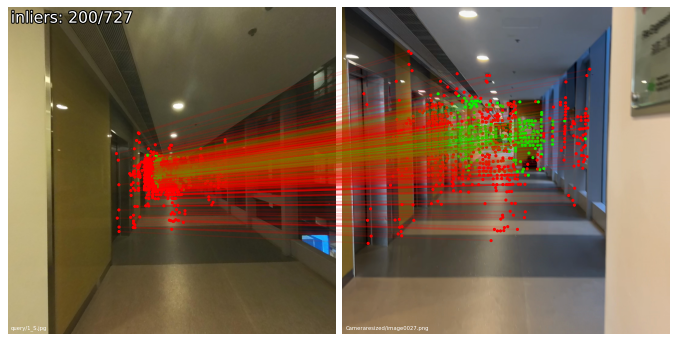

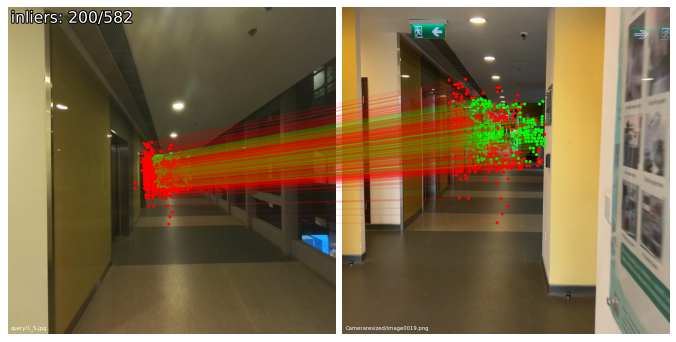

In [14]:
query = 'query/1_S.jpg'
!mkdir -p $images/query && wget $url -O $images/$query -q
# plot_images([read_image(images / query)], dpi=75)

references_registered = [model.images[i].name for i in model.reg_image_ids()]
extract_features.main(feature_conf, images, image_list=[query], feature_path=features, overwrite=True)
pairs_from_exhaustive.main(loc_pairs, image_list=[query], ref_list=references_registered)
match_features.main(matcher_conf, loc_pairs, features=features, matches=matches, overwrite=True);

import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

camera = pycolmap.infer_camera_from_image(images / query)
ref_ids = [model.find_image_with_name(n).image_id for n in references_registered]
conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}
localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, camera, ref_ids, features, matches)

print(f'found {ret["num_inliers"]}/{len(ret["inliers"])} inlier correspondences.')
visualization.visualize_loc_from_log(images, query, log, model)

wget: missing URL
Usage: wget [OPTION]... [URL]...

Try `wget --help' for more options.


[2024/11/27 16:09:59 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


  0%|          | 0/1 [00:00<?, ?it/s]

[2024/11/27 16:10:01 hloc INFO] Finished exporting features.
[2024/11/27 16:10:01 hloc INFO] Found 273 pairs.
[2024/11/27 16:10:01 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


  0%|          | 0/273 [00:00<?, ?it/s]

[2024/11/27 16:10:17 hloc INFO] Finished exporting matches.


found 952/9083 inlier correspondences.


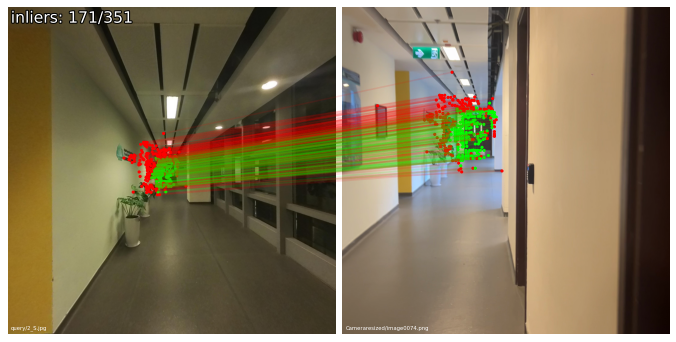

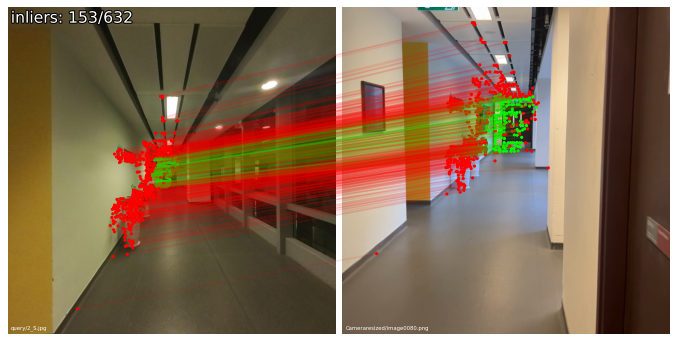

In [15]:
query = 'query/2_S.jpg'
!mkdir -p $images/query && wget $url -O $images/$query -q
# plot_images([read_image(images / query)], dpi=75)

references_registered = [model.images[i].name for i in model.reg_image_ids()]
extract_features.main(feature_conf, images, image_list=[query], feature_path=features, overwrite=True)
pairs_from_exhaustive.main(loc_pairs, image_list=[query], ref_list=references_registered)
match_features.main(matcher_conf, loc_pairs, features=features, matches=matches, overwrite=True);

import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

camera = pycolmap.infer_camera_from_image(images / query)
ref_ids = [model.find_image_with_name(n).image_id for n in references_registered]
conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}
localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, camera, ref_ids, features, matches)

print(f'found {ret["num_inliers"]}/{len(ret["inliers"])} inlier correspondences.')
visualization.visualize_loc_from_log(images, query, log, model)

wget: missing URL
Usage: wget [OPTION]... [URL]...

Try `wget --help' for more options.


[2024/11/27 16:11:00 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


  0%|          | 0/1 [00:00<?, ?it/s]

[2024/11/27 16:11:02 hloc INFO] Finished exporting features.
[2024/11/27 16:11:02 hloc INFO] Found 273 pairs.
[2024/11/27 16:11:02 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


  0%|          | 0/273 [00:00<?, ?it/s]

[2024/11/27 16:11:16 hloc INFO] Finished exporting matches.


found 151/3093 inlier correspondences.


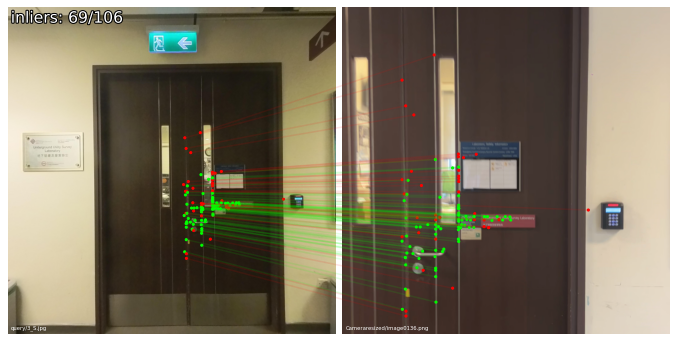

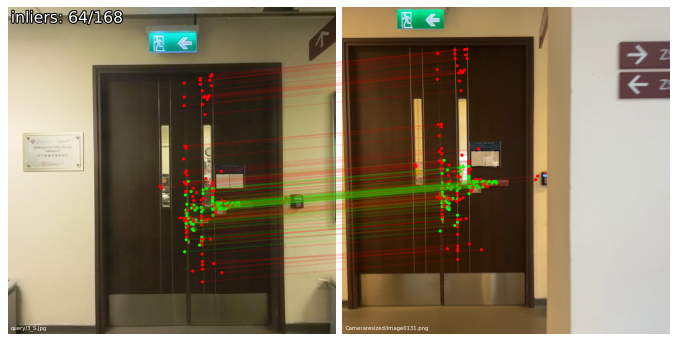

In [16]:
query = 'query/3_S.jpg'
!mkdir -p $images/query && wget $url -O $images/$query -q
# plot_images([read_image(images / query)], dpi=75)

references_registered = [model.images[i].name for i in model.reg_image_ids()]
extract_features.main(feature_conf, images, image_list=[query], feature_path=features, overwrite=True)
pairs_from_exhaustive.main(loc_pairs, image_list=[query], ref_list=references_registered)
match_features.main(matcher_conf, loc_pairs, features=features, matches=matches, overwrite=True);

import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

camera = pycolmap.infer_camera_from_image(images / query)
ref_ids = [model.find_image_with_name(n).image_id for n in references_registered]
conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}
localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, camera, ref_ids, features, matches)

print(f'found {ret["num_inliers"]}/{len(ret["inliers"])} inlier correspondences.')
visualization.visualize_loc_from_log(images, query, log, model)

wget: missing URL
Usage: wget [OPTION]... [URL]...

Try `wget --help' for more options.


[2024/11/27 16:11:30 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


  0%|          | 0/1 [00:00<?, ?it/s]

[2024/11/27 16:11:33 hloc INFO] Finished exporting features.
[2024/11/27 16:11:33 hloc INFO] Found 273 pairs.
[2024/11/27 16:11:33 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


  0%|          | 0/273 [00:00<?, ?it/s]

[2024/11/27 16:11:46 hloc INFO] Finished exporting matches.


found 172/8088 inlier correspondences.


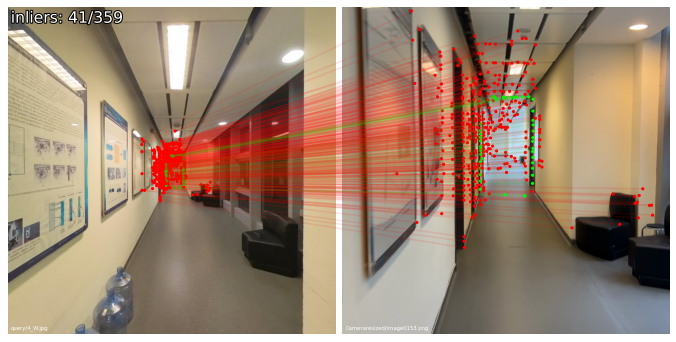

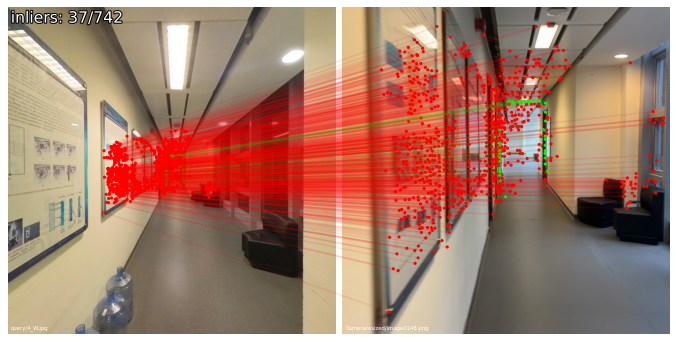

In [17]:
query = 'query/4_W.jpg'
!mkdir -p $images/query && wget $url -O $images/$query -q
# plot_images([read_image(images / query)], dpi=75)

references_registered = [model.images[i].name for i in model.reg_image_ids()]
extract_features.main(feature_conf, images, image_list=[query], feature_path=features, overwrite=True)
pairs_from_exhaustive.main(loc_pairs, image_list=[query], ref_list=references_registered)
match_features.main(matcher_conf, loc_pairs, features=features, matches=matches, overwrite=True);

import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

camera = pycolmap.infer_camera_from_image(images / query)
ref_ids = [model.find_image_with_name(n).image_id for n in references_registered]
conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}
localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, camera, ref_ids, features, matches)

print(f'found {ret["num_inliers"]}/{len(ret["inliers"])} inlier correspondences.')
visualization.visualize_loc_from_log(images, query, log, model)

wget: missing URL
Usage: wget [OPTION]... [URL]...

Try `wget --help' for more options.


[2024/11/27 16:12:16 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


  0%|          | 0/1 [00:00<?, ?it/s]

[2024/11/27 16:12:19 hloc INFO] Finished exporting features.
[2024/11/27 16:12:19 hloc INFO] Found 273 pairs.
[2024/11/27 16:12:19 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


  0%|          | 0/273 [00:00<?, ?it/s]

[2024/11/27 16:12:32 hloc INFO] Finished exporting matches.


found 256/4569 inlier correspondences.


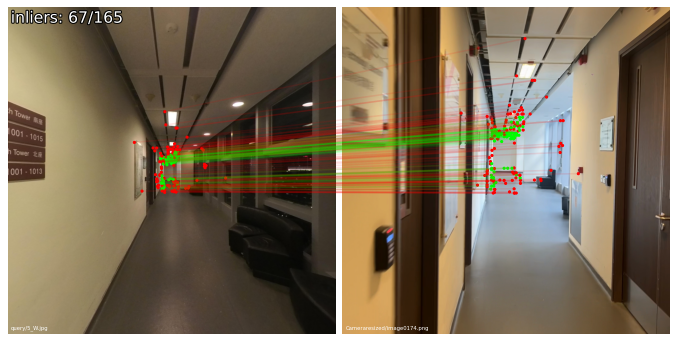

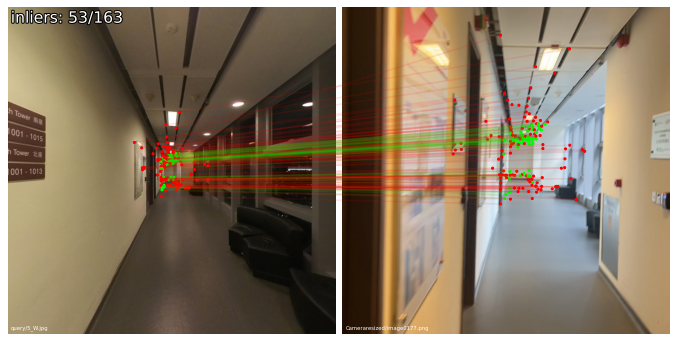

In [18]:
query = 'query/5_W.jpg'
!mkdir -p $images/query && wget $url -O $images/$query -q
# plot_images([read_image(images / query)], dpi=75)

references_registered = [model.images[i].name for i in model.reg_image_ids()]
extract_features.main(feature_conf, images, image_list=[query], feature_path=features, overwrite=True)
pairs_from_exhaustive.main(loc_pairs, image_list=[query], ref_list=references_registered)
match_features.main(matcher_conf, loc_pairs, features=features, matches=matches, overwrite=True);

import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

camera = pycolmap.infer_camera_from_image(images / query)
ref_ids = [model.find_image_with_name(n).image_id for n in references_registered]
conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}
localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, camera, ref_ids, features, matches)

print(f'found {ret["num_inliers"]}/{len(ret["inliers"])} inlier correspondences.')
visualization.visualize_loc_from_log(images, query, log, model)

wget: missing URL
Usage: wget [OPTION]... [URL]...

Try `wget --help' for more options.


[2024/11/27 16:12:53 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


  0%|          | 0/1 [00:00<?, ?it/s]

[2024/11/27 16:12:56 hloc INFO] Finished exporting features.
[2024/11/27 16:12:56 hloc INFO] Found 273 pairs.
[2024/11/27 16:12:56 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


  0%|          | 0/273 [00:00<?, ?it/s]

[2024/11/27 16:13:10 hloc INFO] Finished exporting matches.


found 143/2984 inlier correspondences.


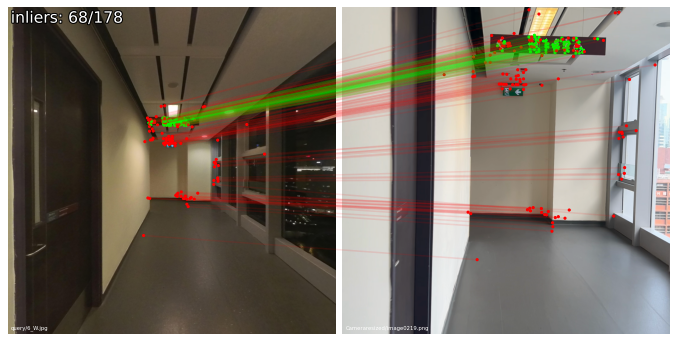

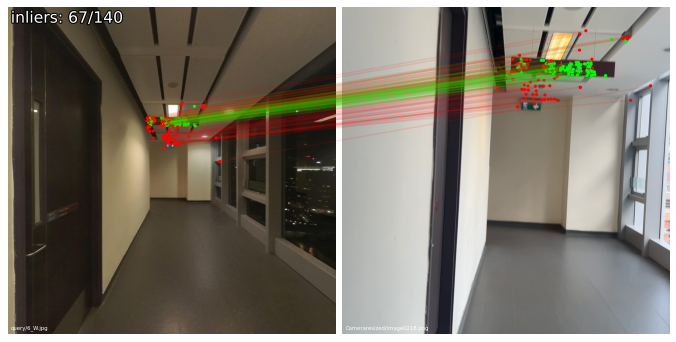

In [19]:
query = 'query/6_W.jpg'
!mkdir -p $images/query && wget $url -O $images/$query -q
# plot_images([read_image(images / query)], dpi=75)

references_registered = [model.images[i].name for i in model.reg_image_ids()]
extract_features.main(feature_conf, images, image_list=[query], feature_path=features, overwrite=True)
pairs_from_exhaustive.main(loc_pairs, image_list=[query], ref_list=references_registered)
match_features.main(matcher_conf, loc_pairs, features=features, matches=matches, overwrite=True);

import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

camera = pycolmap.infer_camera_from_image(images / query)
ref_ids = [model.find_image_with_name(n).image_id for n in references_registered]
conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}
localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, camera, ref_ids, features, matches)

print(f'found {ret["num_inliers"]}/{len(ret["inliers"])} inlier correspondences.')
visualization.visualize_loc_from_log(images, query, log, model)

wget: missing URL
Usage: wget [OPTION]... [URL]...

Try `wget --help' for more options.


[2024/11/27 16:13:26 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


  0%|          | 0/1 [00:00<?, ?it/s]

[2024/11/27 16:13:28 hloc INFO] Finished exporting features.
[2024/11/27 16:13:28 hloc INFO] Found 273 pairs.
[2024/11/27 16:13:28 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


  0%|          | 0/273 [00:00<?, ?it/s]

[2024/11/27 16:13:44 hloc INFO] Finished exporting matches.


found 373/7197 inlier correspondences.


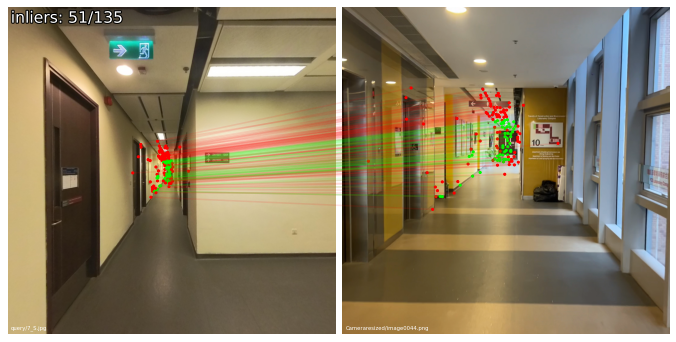

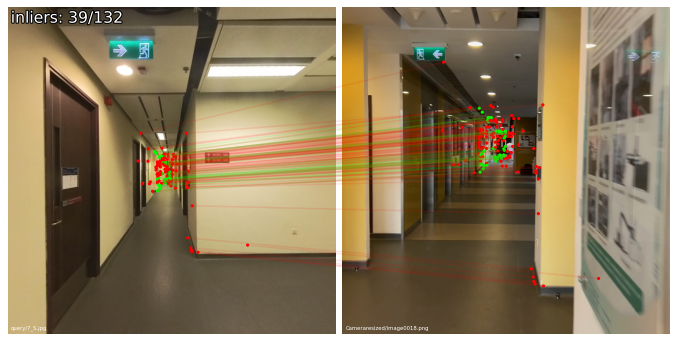

In [20]:
query = 'query/7_S.jpg'
!mkdir -p $images/query && wget $url -O $images/$query -q
# plot_images([read_image(images / query)], dpi=75)

references_registered = [model.images[i].name for i in model.reg_image_ids()]
extract_features.main(feature_conf, images, image_list=[query], feature_path=features, overwrite=True)
pairs_from_exhaustive.main(loc_pairs, image_list=[query], ref_list=references_registered)
match_features.main(matcher_conf, loc_pairs, features=features, matches=matches, overwrite=True);

import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

camera = pycolmap.infer_camera_from_image(images / query)
ref_ids = [model.find_image_with_name(n).image_id for n in references_registered]
conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}
localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, camera, ref_ids, features, matches)

print(f'found {ret["num_inliers"]}/{len(ret["inliers"])} inlier correspondences.')
visualization.visualize_loc_from_log(images, query, log, model)

wget: missing URL
Usage: wget [OPTION]... [URL]...

Try `wget --help' for more options.


[2024/11/27 16:14:05 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


  0%|          | 0/1 [00:00<?, ?it/s]

[2024/11/27 16:14:08 hloc INFO] Finished exporting features.
[2024/11/27 16:14:08 hloc INFO] Found 273 pairs.
[2024/11/27 16:14:08 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


  0%|          | 0/273 [00:00<?, ?it/s]

[2024/11/27 16:14:21 hloc INFO] Finished exporting matches.


found 95/2829 inlier correspondences.


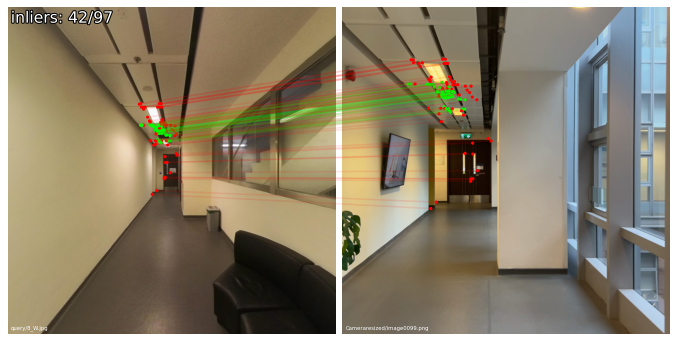

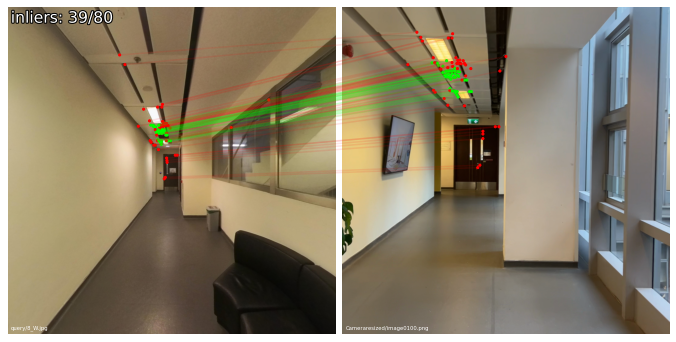

In [21]:
query = 'query/8_W.jpg'
!mkdir -p $images/query && wget $url -O $images/$query -q
# plot_images([read_image(images / query)], dpi=75)

references_registered = [model.images[i].name for i in model.reg_image_ids()]
extract_features.main(feature_conf, images, image_list=[query], feature_path=features, overwrite=True)
pairs_from_exhaustive.main(loc_pairs, image_list=[query], ref_list=references_registered)
match_features.main(matcher_conf, loc_pairs, features=features, matches=matches, overwrite=True);

import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

camera = pycolmap.infer_camera_from_image(images / query)
ref_ids = [model.find_image_with_name(n).image_id for n in references_registered]
conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}
localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, camera, ref_ids, features, matches)

print(f'found {ret["num_inliers"]}/{len(ret["inliers"])} inlier correspondences.')
visualization.visualize_loc_from_log(images, query, log, model)

wget: missing URL
Usage: wget [OPTION]... [URL]...

Try `wget --help' for more options.


[2024/11/27 16:14:36 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


  0%|          | 0/1 [00:00<?, ?it/s]

[2024/11/27 16:14:39 hloc INFO] Finished exporting features.
[2024/11/27 16:14:39 hloc INFO] Found 273 pairs.
[2024/11/27 16:14:39 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


  0%|          | 0/273 [00:00<?, ?it/s]

[2024/11/27 16:14:52 hloc INFO] Finished exporting matches.


found 61/1488 inlier correspondences.


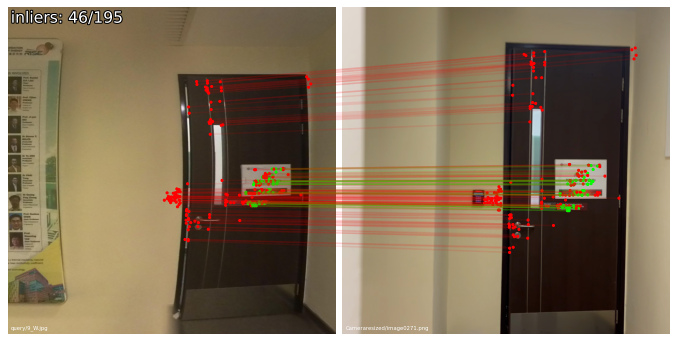

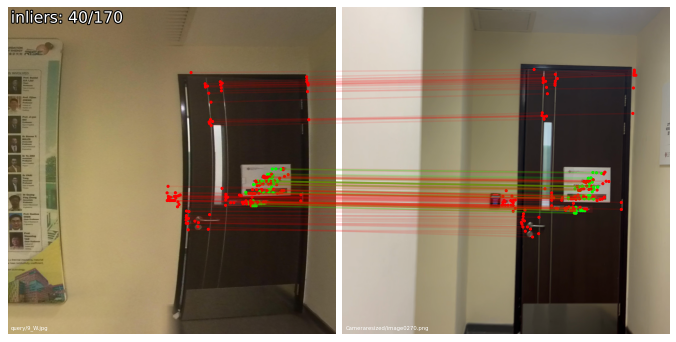

In [22]:
query = 'query/9_W.jpg'
!mkdir -p $images/query && wget $url -O $images/$query -q
# plot_images([read_image(images / query)], dpi=75)

references_registered = [model.images[i].name for i in model.reg_image_ids()]
extract_features.main(feature_conf, images, image_list=[query], feature_path=features, overwrite=True)
pairs_from_exhaustive.main(loc_pairs, image_list=[query], ref_list=references_registered)
match_features.main(matcher_conf, loc_pairs, features=features, matches=matches, overwrite=True);

import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

camera = pycolmap.infer_camera_from_image(images / query)
ref_ids = [model.find_image_with_name(n).image_id for n in references_registered]
conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}
localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, camera, ref_ids, features, matches)

print(f'found {ret["num_inliers"]}/{len(ret["inliers"])} inlier correspondences.')
visualization.visualize_loc_from_log(images, query, log, model)

wget: missing URL
Usage: wget [OPTION]... [URL]...

Try `wget --help' for more options.


[2024/11/27 16:15:05 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


  0%|          | 0/1 [00:00<?, ?it/s]

[2024/11/27 16:15:08 hloc INFO] Finished exporting features.
[2024/11/27 16:15:08 hloc INFO] Found 273 pairs.
[2024/11/27 16:15:08 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


  0%|          | 0/273 [00:00<?, ?it/s]

[2024/11/27 16:15:22 hloc INFO] Finished exporting matches.


found 312/4800 inlier correspondences.


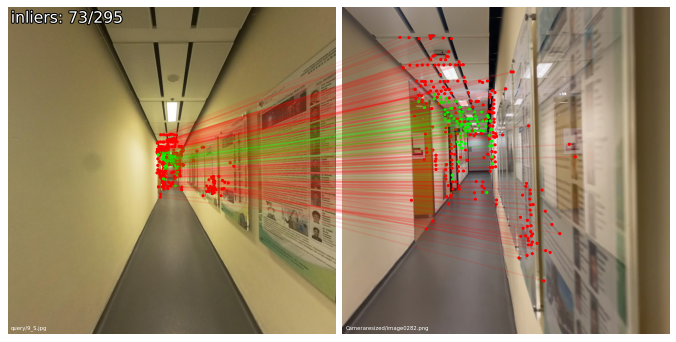

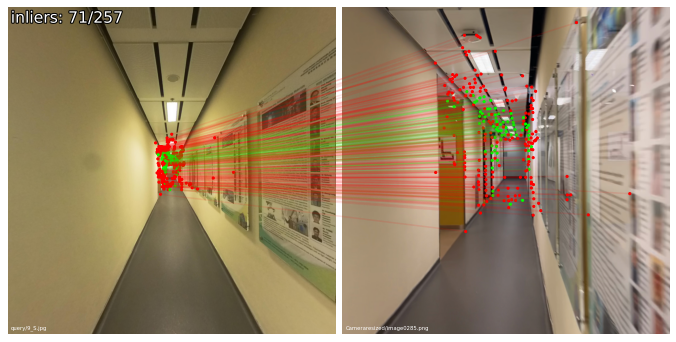

In [23]:
query = 'query/9_S.jpg'
!mkdir -p $images/query && wget $url -O $images/$query -q
# plot_images([read_image(images / query)], dpi=75)

references_registered = [model.images[i].name for i in model.reg_image_ids()]
extract_features.main(feature_conf, images, image_list=[query], feature_path=features, overwrite=True)
pairs_from_exhaustive.main(loc_pairs, image_list=[query], ref_list=references_registered)
match_features.main(matcher_conf, loc_pairs, features=features, matches=matches, overwrite=True);

import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

camera = pycolmap.infer_camera_from_image(images / query)
ref_ids = [model.find_image_with_name(n).image_id for n in references_registered]
conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}
localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, camera, ref_ids, features, matches)

print(f'found {ret["num_inliers"]}/{len(ret["inliers"])} inlier correspondences.')
visualization.visualize_loc_from_log(images, query, log, model)

wget: missing URL
Usage: wget [OPTION]... [URL]...

Try `wget --help' for more options.


[2024/11/27 16:15:39 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


  0%|          | 0/1 [00:00<?, ?it/s]

[2024/11/27 16:15:42 hloc INFO] Finished exporting features.
[2024/11/27 16:15:42 hloc INFO] Found 273 pairs.
[2024/11/27 16:15:42 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


  0%|          | 0/273 [00:00<?, ?it/s]

[2024/11/27 16:15:56 hloc INFO] Finished exporting matches.


found 511/6195 inlier correspondences.


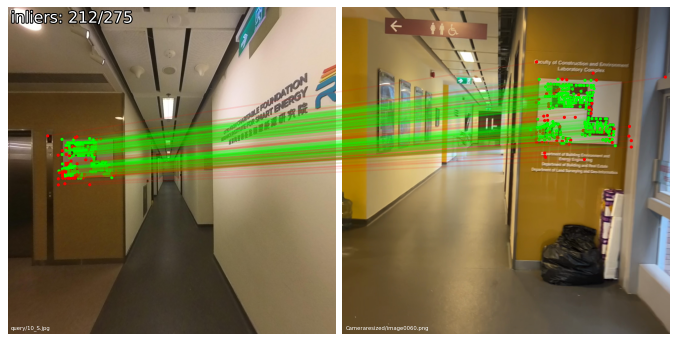

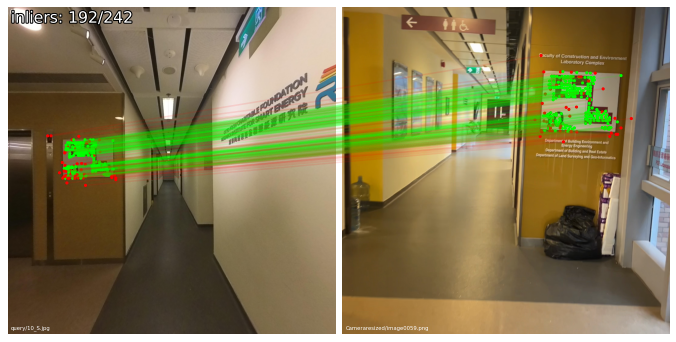

In [24]:
query = 'query/10_S.jpg'
!mkdir -p $images/query && wget $url -O $images/$query -q
# plot_images([read_image(images / query)], dpi=75)

references_registered = [model.images[i].name for i in model.reg_image_ids()]
extract_features.main(feature_conf, images, image_list=[query], feature_path=features, overwrite=True)
pairs_from_exhaustive.main(loc_pairs, image_list=[query], ref_list=references_registered)
match_features.main(matcher_conf, loc_pairs, features=features, matches=matches, overwrite=True);

import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

camera = pycolmap.infer_camera_from_image(images / query)
ref_ids = [model.find_image_with_name(n).image_id for n in references_registered]
conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}
localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, camera, ref_ids, features, matches)

print(f'found {ret["num_inliers"]}/{len(ret["inliers"])} inlier correspondences.')
visualization.visualize_loc_from_log(images, query, log, model)

wget: missing URL
Usage: wget [OPTION]... [URL]...

Try `wget --help' for more options.


[2024/11/27 16:16:11 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


  0%|          | 0/1 [00:00<?, ?it/s]

[2024/11/27 16:16:13 hloc INFO] Finished exporting features.
[2024/11/27 16:16:13 hloc INFO] Found 273 pairs.
[2024/11/27 16:16:13 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


  0%|          | 0/273 [00:00<?, ?it/s]

[2024/11/27 16:16:27 hloc INFO] Finished exporting matches.


found 40/1610 inlier correspondences.


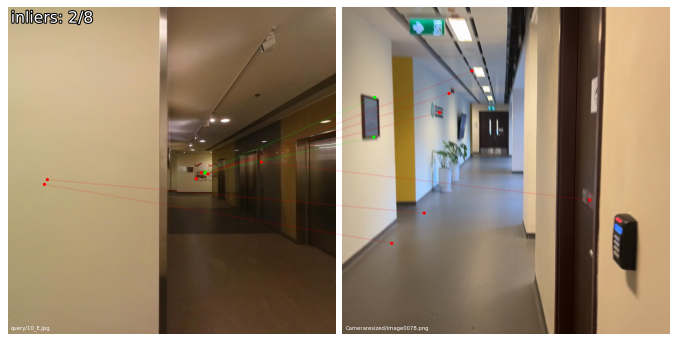

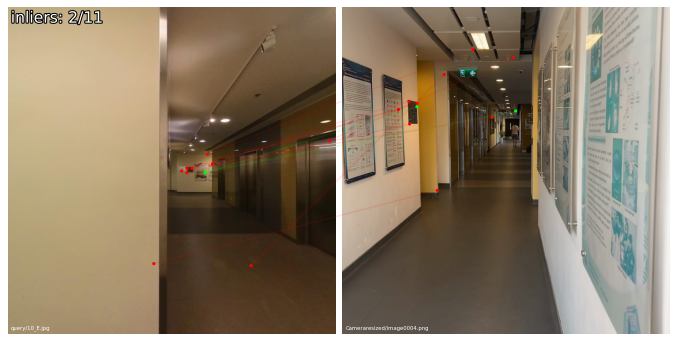

In [25]:
query = 'query/10_E.jpg'
!mkdir -p $images/query && wget $url -O $images/$query -q
# plot_images([read_image(images / query)], dpi=75)

references_registered = [model.images[i].name for i in model.reg_image_ids()]
extract_features.main(feature_conf, images, image_list=[query], feature_path=features, overwrite=True)
pairs_from_exhaustive.main(loc_pairs, image_list=[query], ref_list=references_registered)
match_features.main(matcher_conf, loc_pairs, features=features, matches=matches, overwrite=True);

import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

camera = pycolmap.infer_camera_from_image(images / query)
ref_ids = [model.find_image_with_name(n).image_id for n in references_registered]
conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}
localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, camera, ref_ids, features, matches)

print(f'found {ret["num_inliers"]}/{len(ret["inliers"])} inlier correspondences.')
visualization.visualize_loc_from_log(images, query, log, model)